## Question 4 : Panorama Generation

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
import sys
import glob
import json
import math
from sklearn.cluster import KMeans

In [2]:
path = 'panorama_dataset'
images_paths = glob.glob(os.path.join(path, '*.png'))


Cluster 1:
panorama_dataset\a.png
panorama_dataset\c.png
panorama_dataset\f.png
panorama_dataset\i.png
panorama_dataset\image1.png
panorama_dataset\image2.png
panorama_dataset\n.png
panorama_dataset\q.png

Cluster 2:
panorama_dataset\e.png
panorama_dataset\g.png
panorama_dataset\k.png
panorama_dataset\l.png
panorama_dataset\m.png
panorama_dataset\p.png
panorama_dataset\t.png
panorama_dataset\v.png

Cluster 3:
panorama_dataset\b.png
panorama_dataset\d.png
panorama_dataset\h.png
panorama_dataset\j.png
panorama_dataset\o.png
panorama_dataset\r.png
panorama_dataset\s.png
panorama_dataset\u.png


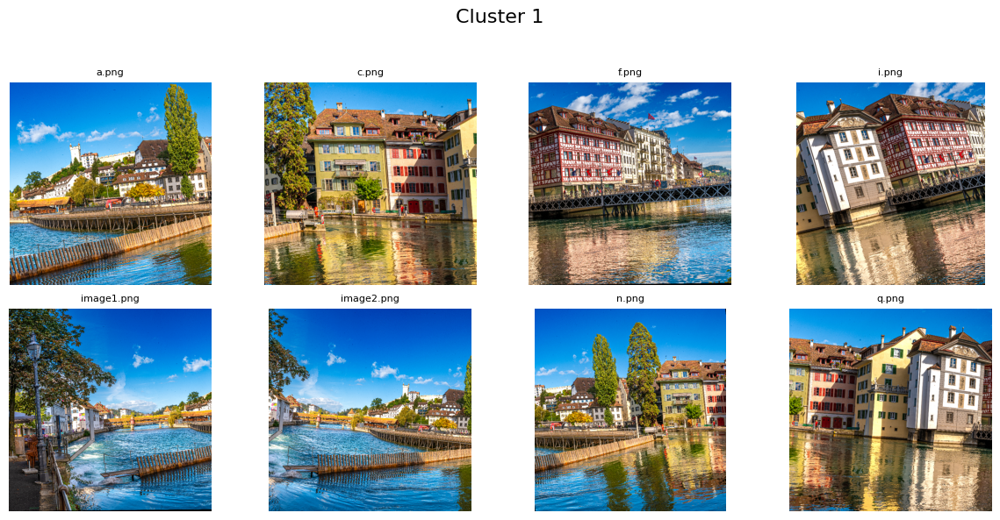

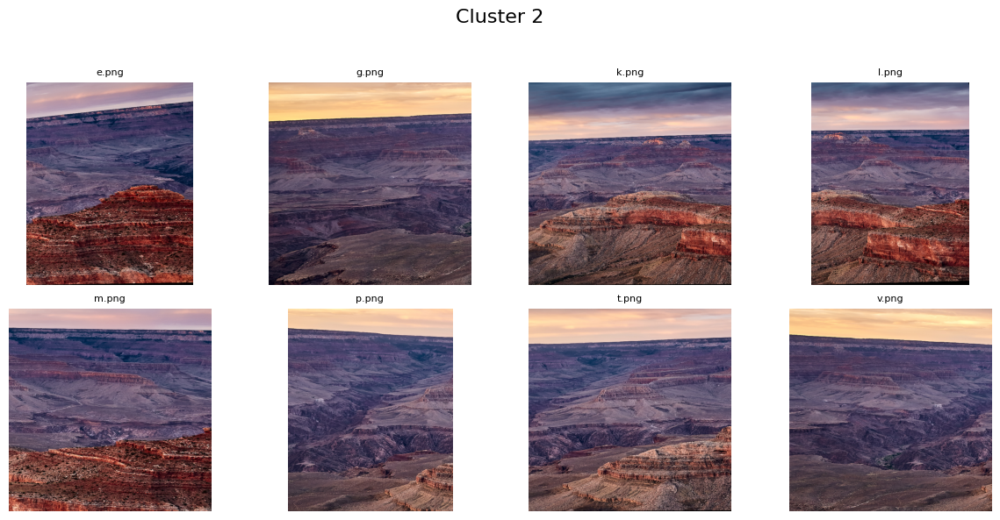

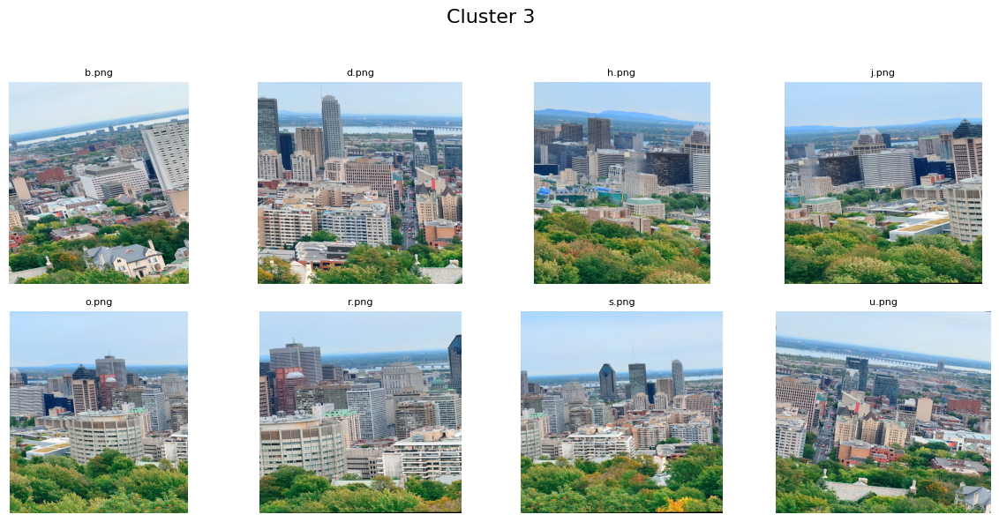

In [12]:
color_histograms = []
images = []

for idx, img_path in enumerate(images_paths):
    image = cv2.imread(img_path)
    hist = cv2.calcHist([image], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
    hist = cv2.normalize(hist, hist).flatten()
    color_histograms.append(hist)
    images.append(img_path)

color_histograms = np.array(color_histograms)

kmeans = KMeans(n_clusters=3, random_state=2022482)
clustering = kmeans.fit_predict(color_histograms)

clusters = {i: [] for i in range(3)}
for img_path, cluster_id in zip(images, clustering):
    clusters[cluster_id].append(img_path)

for cluster_id, img_path in clusters.items():
    print(f"\nCluster {cluster_id+1}:")
    for i in img_path:
        print(i)

for cluster_id, img_list in clusters.items():
    n_images = len(img_list)
    n_cols = 4
    n_rows = math.ceil(n_images / n_cols)
    plt.figure(figsize=(n_cols * 3, n_rows * 3))
    plt.suptitle(f'Cluster {cluster_id+1}', fontsize=16)
    for idx, file in enumerate(img_list):
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(n_rows, n_cols, idx + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(os.path.basename(file), fontsize=8)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()



Cluster 1:
panorama_dataset\a.png
panorama_dataset\b.png
panorama_dataset\c.png
panorama_dataset\d.png
panorama_dataset\f.png
panorama_dataset\i.png
panorama_dataset\image1.png
panorama_dataset\image2.png
panorama_dataset\j.png
panorama_dataset\n.png
panorama_dataset\o.png
panorama_dataset\q.png
panorama_dataset\r.png
panorama_dataset\s.png
panorama_dataset\u.png

Cluster 2:
panorama_dataset\h.png

Cluster 3:
panorama_dataset\e.png
panorama_dataset\g.png
panorama_dataset\k.png
panorama_dataset\l.png
panorama_dataset\m.png
panorama_dataset\p.png
panorama_dataset\t.png
panorama_dataset\v.png


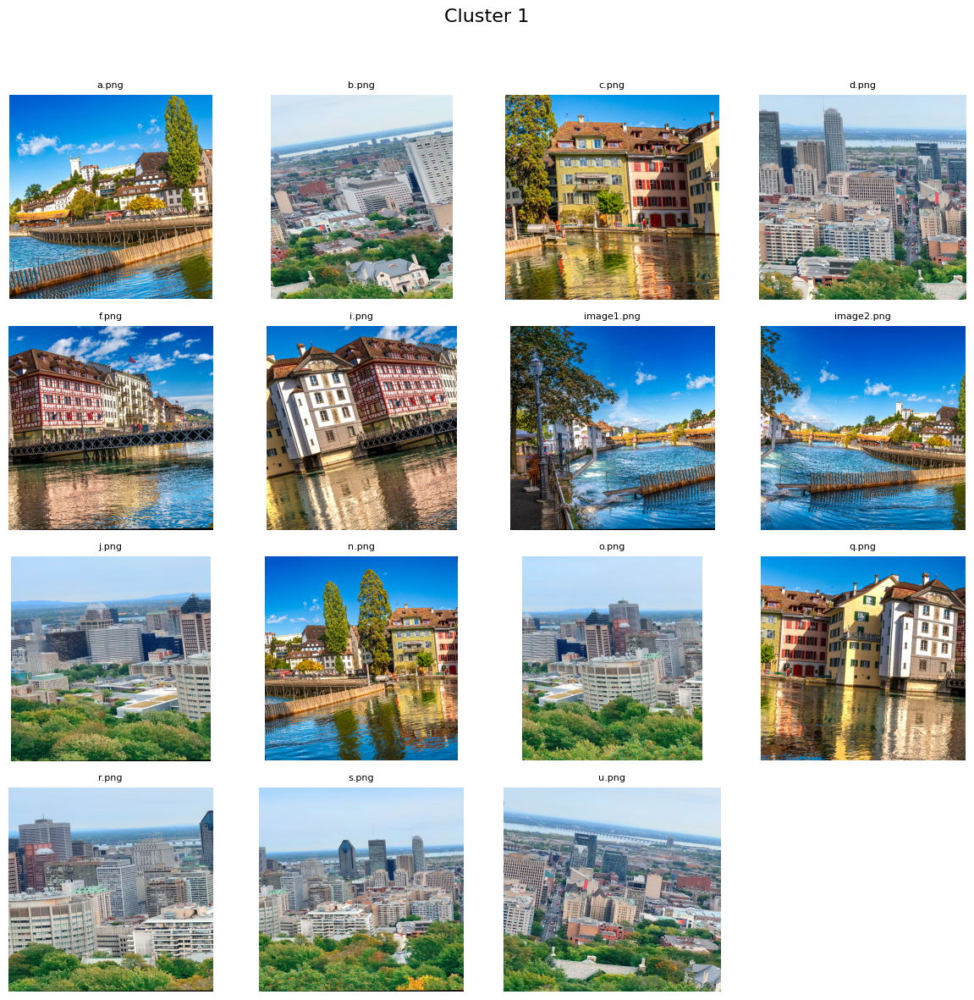

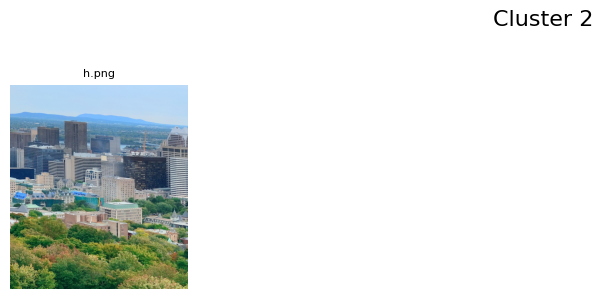

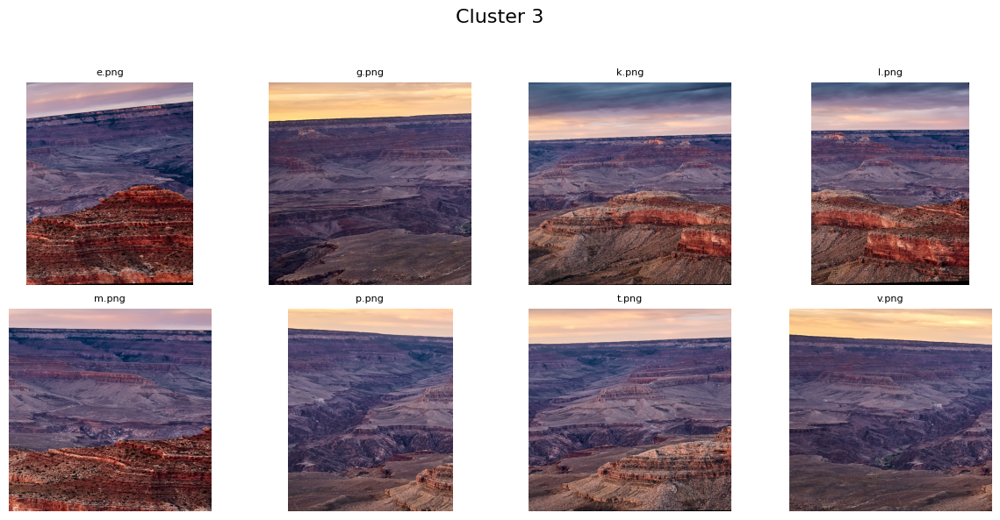

In [4]:
descriptors = [] 

for idx, img_path in enumerate(images_paths):
    image = cv2.imread(img_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    kp, des = sift.detectAndCompute(gray, None)
    if des is not None:
        descriptors.append(des)
    else:
        descriptors.append(None)

valid_descriptors = [des for des in descriptors if des is not None]
valid_descriptors = np.vstack(valid_descriptors)

vocab_kmeans = KMeans(n_clusters=100, random_state=2022482)
vocab_kmeans.fit(valid_descriptors)

bow_histograms = []

for descriptors in descriptors:
    if descriptors is None:
        bow_histograms.append(np.zeros(100))
        continue
    word_indices = vocab_kmeans.predict(descriptors)
    hist, _ = np.histogram(word_indices, bins=np.arange(101))
    # print(type(hist[0]))
    hist = hist.astype('float32')
    hist /= hist.sum()
    bow_histograms.append(hist)

bow_histograms = np.array(bow_histograms)

kmeans = KMeans(n_clusters=3, random_state=2022482)
clustering = kmeans.fit_predict(bow_histograms)

clusters = {i: [] for i in range(3)}
for img_path, cluster_id in zip(images, clustering):
    clusters[cluster_id].append(img_path)

for cluster_id, img_path in clusters.items():
    print(f"\nCluster {cluster_id+1}:")
    for i in img_path:
        print(i)

for cluster_id, img_list in clusters.items():
    n_images = len(img_list)
    n_cols = 4
    n_rows = math.ceil(n_images / n_cols)
    plt.figure(figsize=(n_cols * 3, n_rows * 3))
    plt.suptitle(f'Cluster {cluster_id+1}', fontsize=16)
    for idx, file in enumerate(img_list):
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(n_rows, n_cols, idx + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(os.path.basename(file), fontsize=8)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

Part 1

Number of keypoints in image1: 5890
Number of keypoints in image2: 4510
Descriptor shape for image1: (5890, 128)
Descriptor shape for image2: (4510, 128)


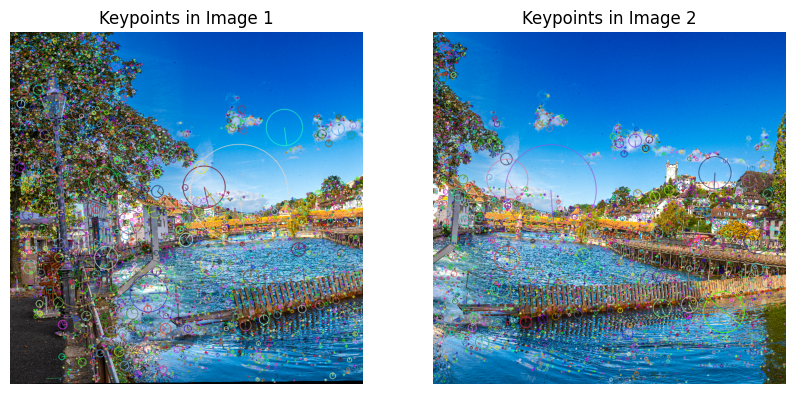

In [5]:
image1 = cv2.imread('panorama_dataset/image1.png')
image2 = cv2.imread('panorama_dataset/image2.png')

gray_image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
gray_image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

sift = cv2.SIFT_create()

kp1, des1 = sift.detectAndCompute(gray_image1, None)
kp2, des2 = sift.detectAndCompute(gray_image2, None)

print(f"Number of keypoints in image1: {len(kp1)}")
print(f"Number of keypoints in image2: {len(kp2)}")

print(f"Descriptor shape for image1: {des1.shape if des1 is not None else 'None'}")
print(f"Descriptor shape for image2: {des2.shape if des2 is not None else 'None'}")

image1_kp = cv2.drawKeypoints(image1, kp1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img2_kp = cv2.drawKeypoints(image2, kp2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image1_kp, cv2.COLOR_BGR2RGB))
plt.title('Keypoints in Image 1')
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(img2_kp, cv2.COLOR_BGR2RGB))
plt.title('Keypoints in Image 2')
plt.axis('off')
plt.show()

Part 2

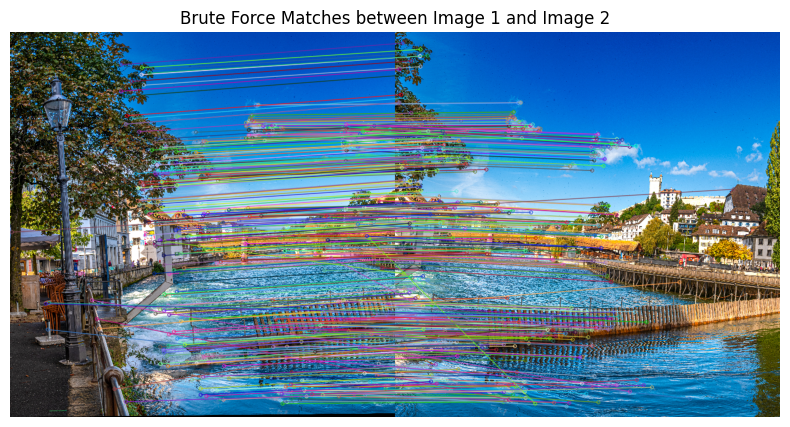

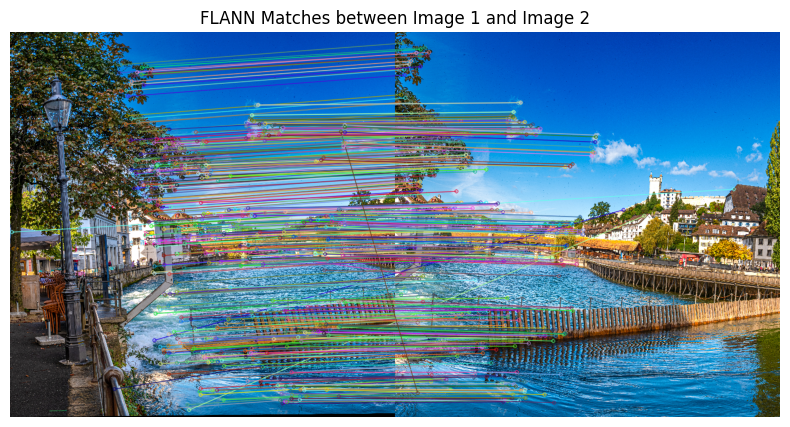

In [6]:
# Brute force matcher
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)
img_matches = cv2.drawMatches(image1, kp1, image2, kp2, matches[:500], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.figure(figsize=(10, 5))
plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
plt.title('Brute Force Matches between Image 1 and Image 2')
plt.axis('off')
plt.show()

# FLANN matcher
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)
matches = flann.knnMatch(des1, des2, k=2)
good_matches = []
for i,(m,n) in enumerate(matches):
    if m.distance < 0.7*n.distance:
        good_matches.append(m)
img_matches = cv2.drawMatches(image1, kp1, image2, kp2, good_matches[:500], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.figure(figsize=(10, 5))
plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
plt.title('FLANN Matches between Image 1 and Image 2')
plt.axis('off')
plt.show()

Part 3

In [7]:
src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
print(f"Homography matrix:\n{M}")

homography_df = pd.DataFrame(M)
homography_df.to_csv('2022482_homography.csv', index=False, header=False)

Homography matrix:
[[ 8.99035177e-01 -1.31402388e-01 -1.64431483e+02]
 [ 1.43246467e-01  9.90487689e-01 -6.94275454e+01]
 [-1.52172749e-07  1.71505548e-07  1.00000000e+00]]


Part 4

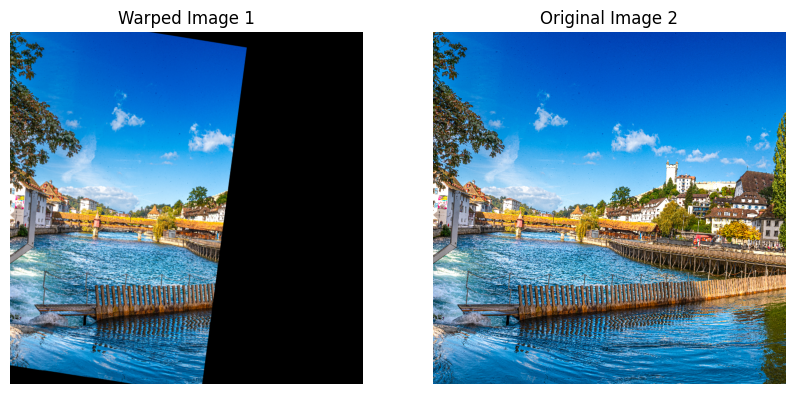

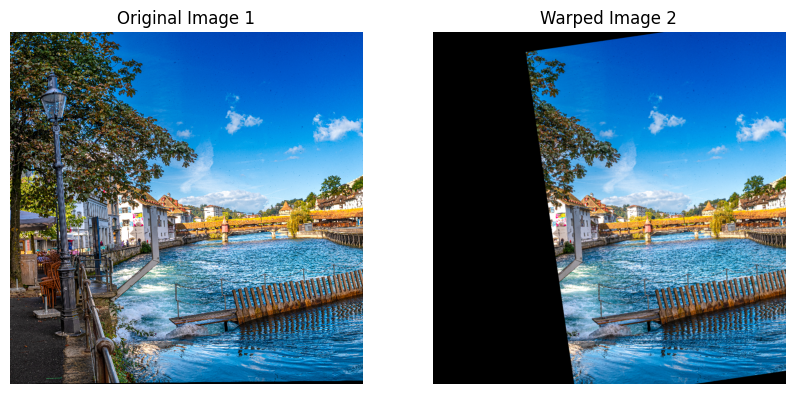

In [8]:
height1, width1 = image1.shape[:2]
height2, width2 = image2.shape[:2]

# Warp image1 using Homography matrix
warped_image1 = cv2.warpPerspective(image1, M, (width2, height2))
corners1 = np.array([[0, 0], [width1, 0], [width1, height1], [0, height1]], dtype=np.float32)
warped_corners1 = cv2.perspectiveTransform(corners1.reshape(-1, 1, 2), M)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(warped_image1, cv2.COLOR_BGR2RGB))
plt.title('Warped Image 1')
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title('Original Image 2')
plt.axis('off')
plt.show()

# Warp image2 using the inverse of the Homography matrix
M_inv = np.linalg.inv(M)
warped_image2 = cv2.warpPerspective(image2, M_inv, (width1, height1))
corners2 = np.array([[0, 0], [width2, 0], [width2, height2], [0, height2]], dtype=np.float32)
warped_corners2 = cv2.perspectiveTransform(corners2.reshape(-1, 1, 2), M)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
plt.title('Original Image 1')
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(warped_image2, cv2.COLOR_BGR2RGB))
plt.title('Warped Image 2')
plt.axis('off')
plt.show()

Part 5

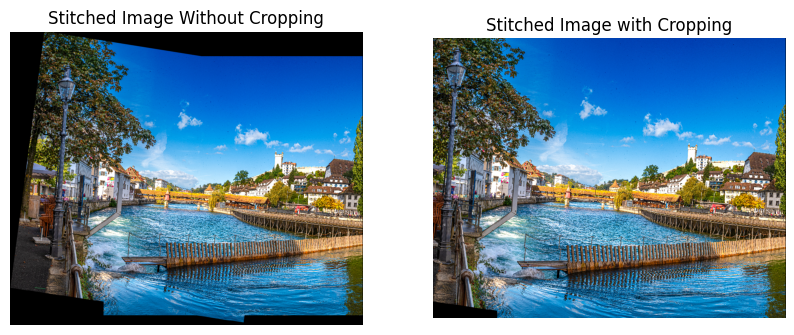

In [ ]:
all_corners = np.vstack((warped_corners1, corners2.reshape(-1, 1, 2)))
x_min, y_min = np.min(all_corners[:, 0, :], axis=0).astype(int) - 1
x_max, y_max = np.max(all_corners[:, 0, :], axis=0).astype(int) + 1

translation = np.array([[1, 0, -x_min],
                        [0, 1, -y_min],
                        [0, 0, 1]])


# translation + original homography
full_homography = translation @ M
stitched_image = cv2.warpPerspective(image1, full_homography, (x_max - x_min, y_max - y_min))
stitched_image[-y_min:-y_min+height2, -x_min:-x_min+width2] = image2

stitched_image_cropped = np.zeros((max(height1, height2), max(width1, width2), 3), dtype=np.uint8)
stitched_image_cropped[:height2, :width2] = image2
non_black_pixels = np.any(warped_image1 > 0, axis=-1)
stitched_image_cropped[non_black_pixels] = warped_image1[non_black_pixels]
mask = np.zeros((max(height1, height2), max(width1, width2)), dtype=np.uint8)
mask[:height1, :width1] = 255
mask[:height2, :width2] = 255
stitched_image_cropped = cv2.bitwise_and(stitched_image_cropped, stitched_image_cropped, mask=mask)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(stitched_image, cv2.COLOR_BGR2RGB))
plt.title("Stitched Image Without Cropping")
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(stitched_image_cropped, cv2.COLOR_BGR2RGB))
plt.title('Stitched Image with Cropping')
plt.axis('off')
plt.show()

Part 6


Stitching Cluster 1 with 8 images
Starting panorama with panorama_dataset\a.png
Finding quality between panorama and f.png: 5
Finding quality between panorama and image1.png: 189
Finding quality between panorama and n.png: 468
Finding quality between panorama and c.png: 4
Finding quality between panorama and q.png: 5
Finding quality between panorama and image2.png: 551
Finding quality between panorama and i.png: 4
Stitching panorama_dataset\image2.png into the panorama with quality score: 551
Stitched panorama_dataset\image2.png successfully. Remaining images: 6
Finding quality between panorama and f.png: 4
Finding quality between panorama and image1.png: 580
Finding quality between panorama and n.png: 303
Finding quality between panorama and c.png: 5
Finding quality between panorama and q.png: 4
Finding quality between panorama and i.png: 4
Stitching panorama_dataset\image1.png into the panorama with quality score: 580
Stitched panorama_dataset\image1.png successfully. Remaining imag

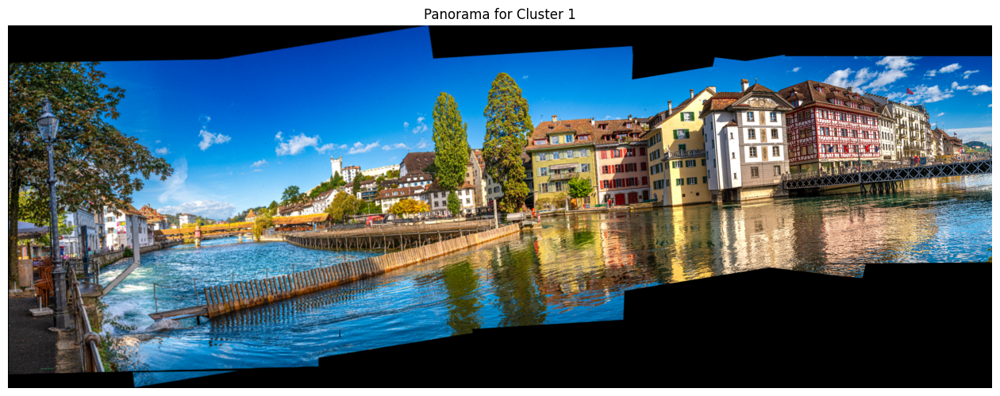


Stitching Cluster 2 with 8 images
Starting panorama with panorama_dataset\e.png
Finding quality between panorama and k.png: 0
Finding quality between panorama and m.png: 661
Finding quality between panorama and g.png: 0
Finding quality between panorama and p.png: 4
Finding quality between panorama and v.png: 0
Finding quality between panorama and l.png: 57
Finding quality between panorama and t.png: -1
Stitching panorama_dataset\m.png into the panorama with quality score: 661
Stitched panorama_dataset\m.png successfully. Remaining images: 6
Finding quality between panorama and k.png: 57
Finding quality between panorama and g.png: 8
Finding quality between panorama and p.png: 4
Finding quality between panorama and v.png: 4
Finding quality between panorama and l.png: 372
Finding quality between panorama and t.png: 4
Stitching panorama_dataset\l.png into the panorama with quality score: 372
Stitched panorama_dataset\l.png successfully. Remaining images: 5
Finding quality between panorama

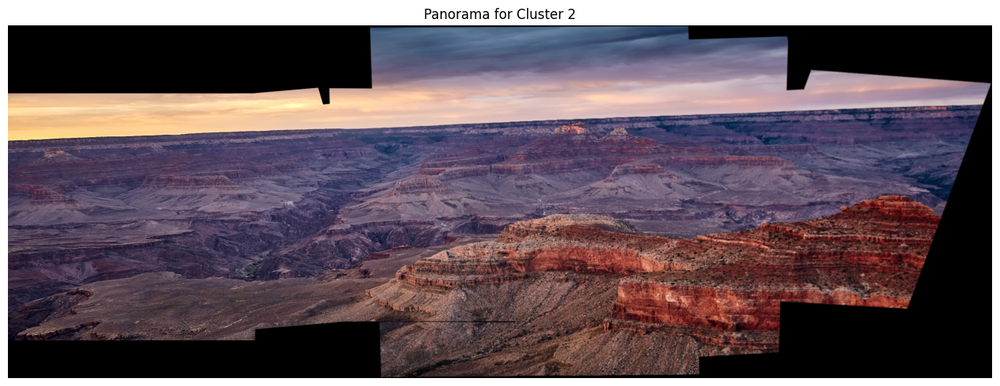


Stitching Cluster 3 with 8 images
Starting panorama with panorama_dataset\b.png
Finding quality between panorama and s.png: 10
Finding quality between panorama and h.png: 4
Finding quality between panorama and r.png: 5
Finding quality between panorama and d.png: 7
Finding quality between panorama and o.png: 5
Finding quality between panorama and u.png: 537
Finding quality between panorama and j.png: 8
Stitching panorama_dataset\u.png into the panorama with quality score: 537
Stitched panorama_dataset\u.png successfully. Remaining images: 6
Finding quality between panorama and s.png: 181
Finding quality between panorama and h.png: 50
Finding quality between panorama and r.png: 10
Finding quality between panorama and d.png: 989
Finding quality between panorama and o.png: 8
Finding quality between panorama and j.png: 11
Stitching panorama_dataset\d.png into the panorama with quality score: 989
Stitched panorama_dataset\d.png successfully. Remaining images: 5
Finding quality between panor

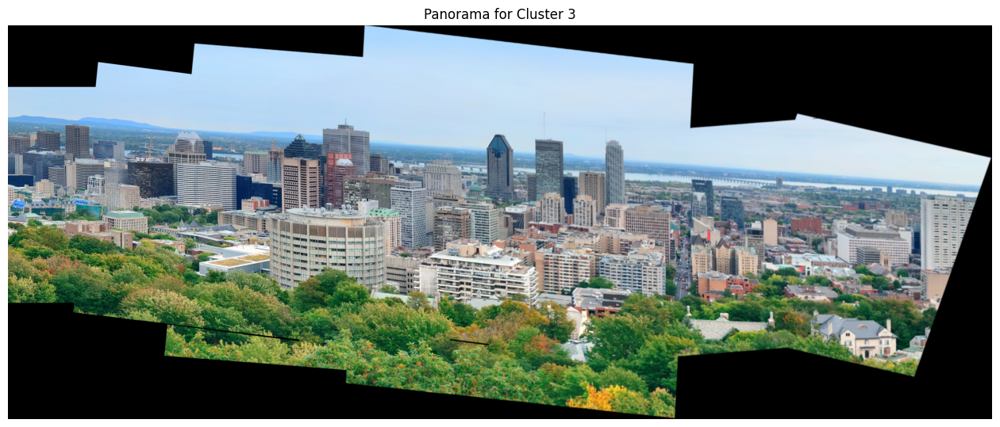

In [29]:
def find_best_pair(image1, image2):

    gray_image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray_image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    sift = cv2.SIFT_create()

    kp1, des1 = sift.detectAndCompute(gray_image1, None)
    kp2, des2 = sift.detectAndCompute(gray_image2, None)

    # FLANN matcher
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des1, des2, k=2)
    good_matches = []
    for i,(m,n) in enumerate(matches):
        if m.distance < 0.7*n.distance:
            good_matches.append(m)

    if len(good_matches) < 4:
        return -1, None

    src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    inliers = int(mask.ravel().sum())
    return inliers, M

def stitching_pair(image1, image2, M=None):
    
    height1, width1 = image1.shape[:2]
    height2, width2 = image2.shape[:2]

    # Warp image1 using Homography matrix
    warped_image1 = cv2.warpPerspective(image1, M, (width2, height2))
    corners1 = np.array([[0, 0], [width1, 0], [width1, height1], [0, height1]], dtype=np.float32)
    warped_corners1 = cv2.perspectiveTransform(corners1.reshape(-1, 1, 2), M)

    # Warp image2 using the inverse of the Homography matrix
    M_inv = np.linalg.inv(M)
    warped_image2 = cv2.warpPerspective(image2, M_inv, (width1, height1))
    corners2 = np.array([[0, 0], [width2, 0], [width2, height2], [0, height2]], dtype=np.float32)
    warped_corners2 = cv2.perspectiveTransform(corners2.reshape(-1, 1, 2), M)

    all_corners = np.vstack((warped_corners1, corners2.reshape(-1, 1, 2)))
    x_min, y_min = np.min(all_corners[:, 0, :], axis=0).astype(int) - 1
    x_max, y_max = np.max(all_corners[:, 0, :], axis=0).astype(int) + 1

    translation = np.array([[1, 0, -x_min],
                            [0, 1, -y_min],
                            [0, 0, 1]])


    # translation + original homography
    full_homography = translation @ M
    stitched_image = cv2.warpPerspective(image1, full_homography, (x_max - x_min, y_max - y_min))
    stitched_image[-y_min:-y_min+height2, -x_min:-x_min+width2] = image2

    return stitched_image

def multi_stitching(cluster_image_paths):

    cluster_image_paths.sort()
    first_image_path = cluster_image_paths[0]
    panorama = cv2.imread(first_image_path)

    print(f"Starting panorama with {first_image_path}")
    
    remaining_paths = set(cluster_image_paths[1:])
    
    while remaining_paths:
        best_quality = 0
        best_M = None
        best_candidate = None
        
        for candidate_path in remaining_paths:
            candidate_img = cv2.imread(candidate_path)           
            quality, M = find_best_pair(panorama, candidate_img)

            print(f"Finding quality between panorama and {os.path.basename(candidate_path)}: {quality}")
            if quality > best_quality:
                best_quality = quality
                best_M = M
                best_candidate = candidate_path

        candidate_img = cv2.imread(best_candidate)
        print(f"Stitching {best_candidate} into the panorama with quality score: {best_quality}")
        stitched = stitching_pair(panorama, candidate_img, best_M)

        panorama = stitched
        remaining_paths.remove(best_candidate)
        print(f"Stitched {best_candidate} successfully. Remaining images: {len(remaining_paths)}")
    
    return panorama

def crop_scene(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    coords = np.column_stack(np.where(gray > 0))
    y0, x0 = coords.min(axis=0)
    y1, x1 = coords.max(axis=0) + 1 
    cropped = image[y0:y1, x0:x1]
    return cropped

panoramas = {}
for cluster_id, img_paths in clusters.items():
    print(f"\nStitching Cluster {cluster_id + 1} with {len(img_paths)} images")
    pano = multi_stitching(img_paths)
    if pano is not None:
        panoramas[cluster_id] = pano
        pano = crop_scene(pano)
        plt.figure(figsize=(16, 8))
        plt.imshow(cv2.cvtColor(pano, cv2.COLOR_BGR2RGB))
        plt.title(f"Panorama for Cluster {cluster_id + 1}")
        plt.axis("off")
        plt.show()


Stitching Cluster 1 with 8 images
Starting panorama with panorama_dataset\a.png
Reprojection error between panorama and f.png: 0.17
Reprojection error between panorama and image1.png: 0.39
Reprojection error between panorama and n.png: 0.53
Reprojection error between panorama and c.png: 0.00
Reprojection error between panorama and q.png: 0.00
Reprojection error between panorama and image2.png: 0.48
Reprojection error between panorama and i.png: 0.00
Stitching panorama_dataset\c.png into the panorama reprojection error: 0.00
Stitched panorama_dataset\c.png successfully. Remaining images: 6
Reprojection error between panorama and f.png: 0.97
Reprojection error between panorama and image1.png: 0.42
Reprojection error between panorama and n.png: 0.43
Reprojection error between panorama and q.png: 0.39
Reprojection error between panorama and image2.png: 1.55
Reprojection error between panorama and i.png: 0.67
Stitching panorama_dataset\q.png into the panorama reprojection error: 0.39
Stitc

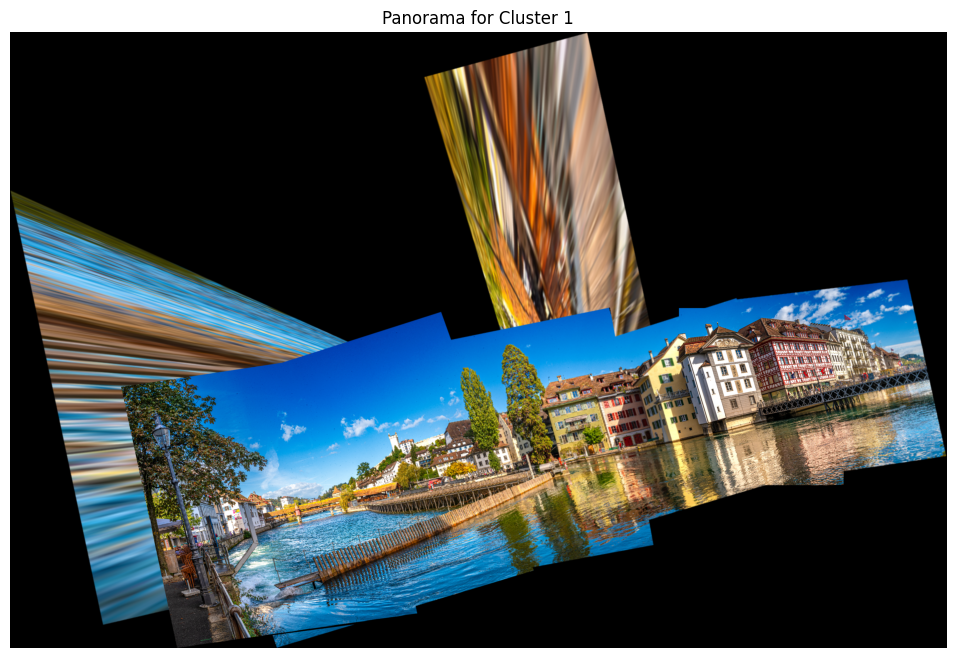


Stitching Cluster 2 with 8 images
Starting panorama with panorama_dataset\e.png
Reprojection error between panorama and k.png: inf
Reprojection error between panorama and m.png: 0.36
Reprojection error between panorama and g.png: inf
Reprojection error between panorama and p.png: 0.00
Reprojection error between panorama and v.png: 0.00
Reprojection error between panorama and l.png: 0.30
Reprojection error between panorama and t.png: inf
Stitching panorama_dataset\p.png into the panorama reprojection error: 0.00
Stitched panorama_dataset\p.png successfully. Remaining images: 6
Reprojection error between panorama and k.png: 0.37
Reprojection error between panorama and m.png: inf
Reprojection error between panorama and g.png: inf
Reprojection error between panorama and v.png: 0.33
Reprojection error between panorama and l.png: 0.00
Reprojection error between panorama and t.png: 0.35
Stitching panorama_dataset\l.png into the panorama reprojection error: 0.00
Stitched panorama_dataset\l.pn

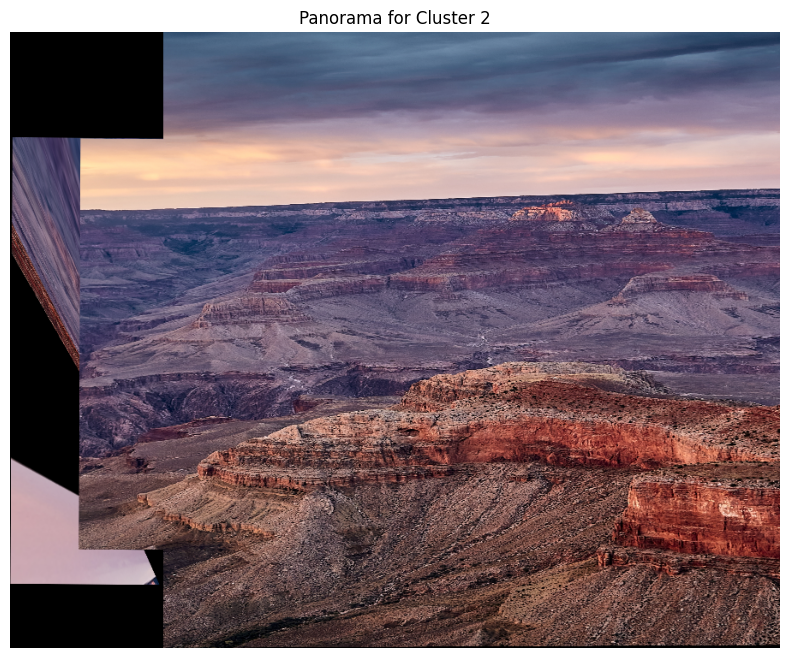


Stitching Cluster 3 with 8 images
Starting panorama with panorama_dataset\b.png
Reprojection error between panorama and s.png: 1.14
Reprojection error between panorama and h.png: 0.00
Reprojection error between panorama and r.png: 0.00
Reprojection error between panorama and d.png: 0.22
Reprojection error between panorama and o.png: 1.00
Reprojection error between panorama and u.png: 0.44
Reprojection error between panorama and j.png: 7.81
Stitching panorama_dataset\h.png into the panorama reprojection error: 0.00
Stitched panorama_dataset\h.png successfully. Remaining images: 6
Reprojection error between panorama and s.png: 1.25
Reprojection error between panorama and r.png: 7.86
Reprojection error between panorama and d.png: 0.81
Reprojection error between panorama and o.png: 0.53
Reprojection error between panorama and u.png: 1.48
Reprojection error between panorama and j.png: 0.24
Stitching panorama_dataset\j.png into the panorama reprojection error: 0.24
Stitched panorama_dataset

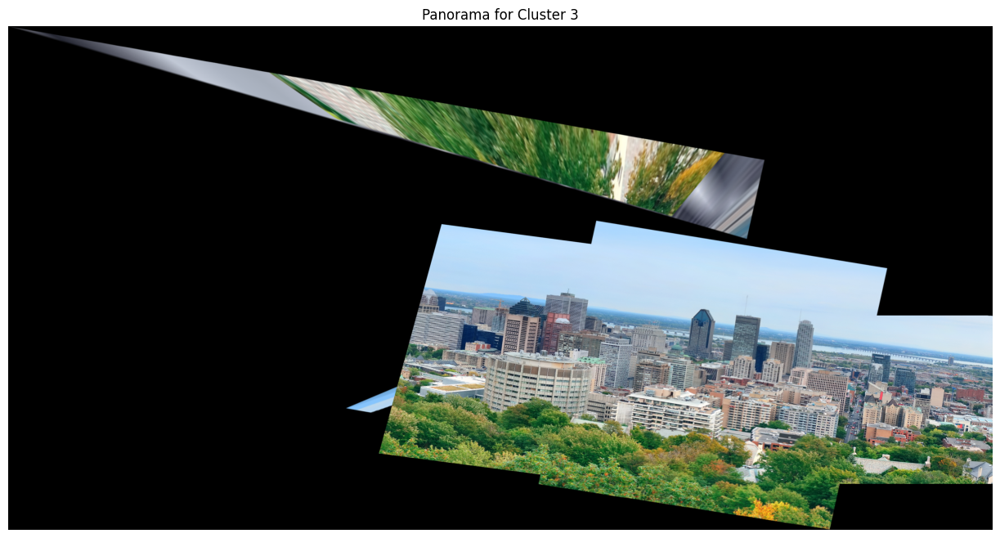

In [32]:
def find_best_pair(image1, image2):

    gray_image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    gray_image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    sift = cv2.SIFT_create()

    kp1, des1 = sift.detectAndCompute(gray_image1, None)
    kp2, des2 = sift.detectAndCompute(gray_image2, None)

    # FLANN matcher
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des1, des2, k=2)
    good_matches = []
    for i,(m,n) in enumerate(matches):
        if m.distance < 0.7*n.distance:
            good_matches.append(m)

    if len(good_matches) < 4:
        return np.inf, None

    src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    
    mask = mask.ravel().astype(bool)
    if mask.sum() < 4:
        return np.inf, None

    projected_pts = cv2.perspectiveTransform(src_pts, M)
    errors = np.linalg.norm(projected_pts[mask] - dst_pts[mask], axis=2)
    avg_error = errors.mean() if len(errors) > 0 else np.inf

    return avg_error, M

def stitching_pair(image1, image2, M=None):
    
    height1, width1 = image1.shape[:2]
    height2, width2 = image2.shape[:2]

    # Warp image1 using Homography matrix
    warped_image1 = cv2.warpPerspective(image1, M, (width2, height2))
    corners1 = np.array([[0, 0], [width1, 0], [width1, height1], [0, height1]], dtype=np.float32)
    warped_corners1 = cv2.perspectiveTransform(corners1.reshape(-1, 1, 2), M)

    # Warp image2 using the inverse of the Homography matrix
    M_inv = np.linalg.inv(M)
    warped_image2 = cv2.warpPerspective(image2, M_inv, (width1, height1))
    corners2 = np.array([[0, 0], [width2, 0], [width2, height2], [0, height2]], dtype=np.float32)
    warped_corners2 = cv2.perspectiveTransform(corners2.reshape(-1, 1, 2), M)

    all_corners = np.vstack((warped_corners1, corners2.reshape(-1, 1, 2)))
    x_min, y_min = np.min(all_corners[:, 0, :], axis=0).astype(int) - 1
    x_max, y_max = np.max(all_corners[:, 0, :], axis=0).astype(int) + 1

    translation = np.array([[1, 0, -x_min],
                            [0, 1, -y_min],
                            [0, 0, 1]])


    # translation + original homography
    full_homography = translation @ M
    stitched_image = cv2.warpPerspective(image1, full_homography, (x_max - x_min, y_max - y_min))
    stitched_image[-y_min:-y_min+height2, -x_min:-x_min+width2] = image2

    return stitched_image

def multi_stitching(cluster_image_paths):

    cluster_image_paths.sort()
    first_image_path = cluster_image_paths[0]
    panorama = cv2.imread(first_image_path)

    print(f"Starting panorama with {first_image_path}")
    
    remaining_paths = set(cluster_image_paths[1:])
    
    while remaining_paths:
        best_error = np.inf
        best_M = None
        best_candidate = None
        
        for candidate_path in remaining_paths:
            candidate_img = cv2.imread(candidate_path)           
            error, M = find_best_pair(panorama, candidate_img)

            print(f"Reprojection error between panorama and {os.path.basename(candidate_path)}: {error:.2f}")
            if error < best_error:
                best_error = error
                best_M = M
                best_candidate = candidate_path

        candidate_img = cv2.imread(best_candidate)
        print(f"Stitching {best_candidate} into the panorama reprojection error: {best_error:.2f}")
        stitched = stitching_pair(panorama, candidate_img, best_M)

        panorama = stitched
        remaining_paths.remove(best_candidate)
        print(f"Stitched {best_candidate} successfully. Remaining images: {len(remaining_paths)}")
    
    return panorama

def crop_scene(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    coords = np.column_stack(np.where(gray > 0))
    y0, x0 = coords.min(axis=0)
    y1, x1 = coords.max(axis=0) + 1 
    cropped = image[y0:y1, x0:x1]
    return cropped

panoramas = {}
for cluster_id, img_paths in clusters.items():
    print(f"\nStitching Cluster {cluster_id + 1} with {len(img_paths)} images")
    pano = multi_stitching(img_paths)
    if pano is not None:
        panoramas[cluster_id] = pano
        pano = crop_scene(pano)
        plt.figure(figsize=(16, 8))
        plt.imshow(cv2.cvtColor(pano, cv2.COLOR_BGR2RGB))
        plt.title(f"Panorama for Cluster {cluster_id + 1}")
        plt.axis("off")
        plt.show()

Best Panoramas generated

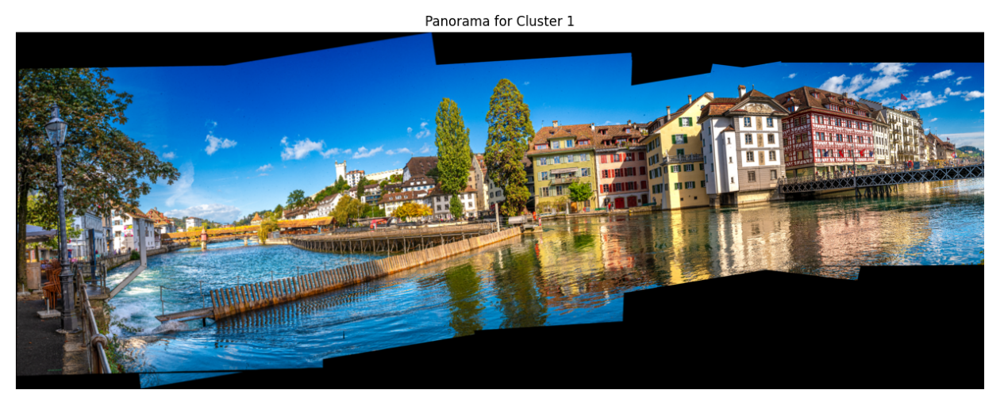

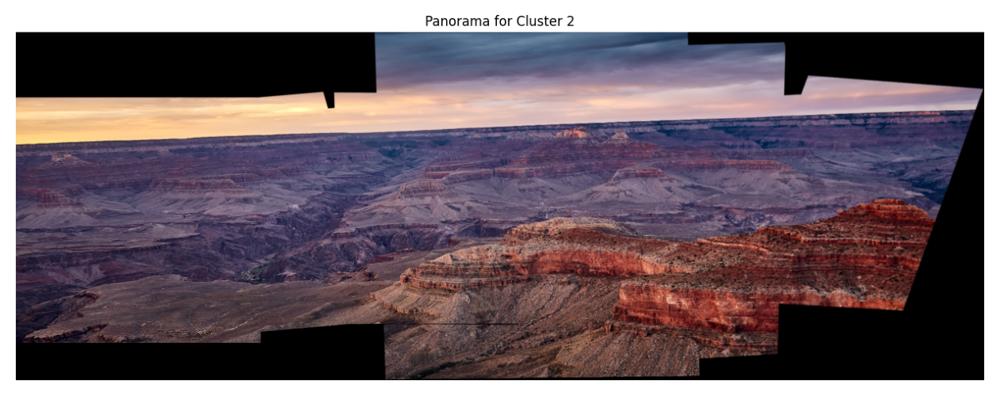

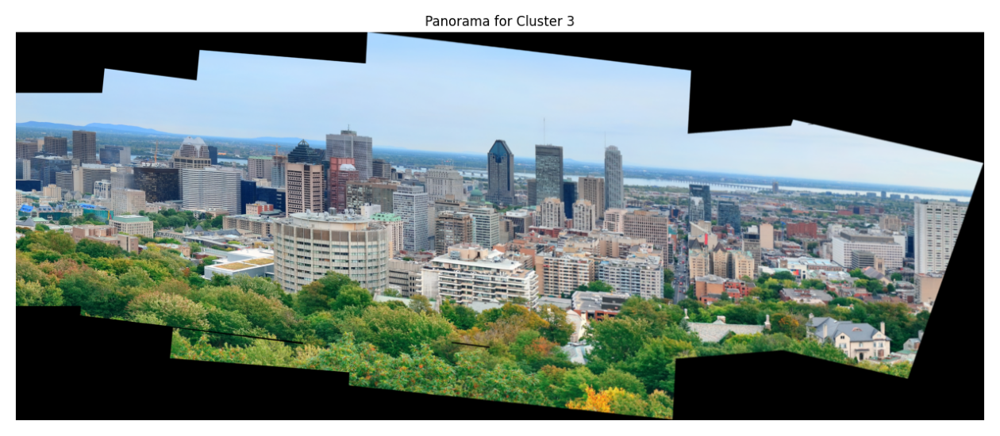

In [ ]:
panorama_cluster_1 = cv2.imread('../panorama_cluster_1_inliers.png')
panorama_cluster_2 = cv2.imread('../panorama_cluster_2_inliers.png')
panorama_cluster_3 = cv2.imread('../panorama_cluster_3_inliers.png')

plt.figure(figsize=(16, 8))
plt.imshow(cv2.cvtColor(panorama_cluster_1, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()

plt.figure(figsize=(16, 8))
plt.imshow(cv2.cvtColor(panorama_cluster_2, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()

plt.figure(figsize=(16, 8))
plt.imshow(cv2.cvtColor(panorama_cluster_3, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()